## Data loading & EDA

In [1]:
pip install pydeck

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 14.5 MB/s eta 0:00:00


In [106]:
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler


df = pd.read_csv('incidents.csv')
df

,id,open_date,name,location,lat,lon,threat,tags,commodity,measure_skim,measure_shore,measure_bio,measure_disperse,measure_burn,max_ptl_release_gallons,posts,description
0,10431,2022-03-21,"Tug Vessel Loses Power, Grounds, and Leaks Die...","Neva Strait, Sitka, AK",57.270000,-135.593330,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"At approximately 0400 on 21-Mar02922, the tug ..."
1,10430,2022-03-17,Compromised Fuel Transfer Pipe Spills Oil into...,"Oswego, NY",43.459410,-76.531650,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 17, 2022, NOAA ERD was notified by Mi..."
2,10429,2022-03-16,Floating Humpback Whale Carcass off of Carolin...,"Carolina Beach, NC, USA",34.031323,-77.830343,Other,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 16, 2022, the Gulf of Mexico Marine M..."
3,10428,2022-03-15,Containership Grounded off Gibson Island in Ch...,"Gibson Island, MD, USA",39.070000,-76.410000,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,"On 15 March 2022, USCG Sector Maryland NCR not..."
4,10426,2022-03-14,"Oil Pipeline Discharge into Cahokia Canal, Edw...","Cahokia Canal, Edwardsville, IL",38.824034,-89.974600,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 14, 2022, USEPA Region 5 contacted th..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4205,6204,1968-06-13,"World Glory; 65 miles ENE of Durban, South Africa","65 miles ENE of Durban, South Africa",-29.633300,32.250000,NaN,NaN,Kuwait crude oil,NaN,NaN,NaN,1.0,NaN,14000000.0,6,"At 1500 on June 13, 1968, the World Glory, bo..."
4206,6203,1968-03-07,"General Colocotronis; Eleuthera Island, Bahamas","Eleuthera Island, Bahamas",25.333300,-76.333300,NaN,NaN,"Venezuelan crude oil, diesel fuel",NaN,NaN,NaN,1.0,1.0,1550000.0,6,"On March 7, 1968, the Greek tank vessel Genera..."
4207,6202,1968-03-03,"Ocean Eagle; San Juan, Puerto Rico","San Juan, Puerto Rico",18.483300,-66.166700,NaN,NaN,Venezuelan light crude oil,NaN,NaN,NaN,1.0,NaN,2940000.0,15,"On the morning of March 3, 1968, the tanker Oc..."
4208,6201,1967-03-18,"Torrey Canyon; Lands End, England","Lands End, England",50.050000,-4.733330,NaN,NaN,Kuwait crude oil,NaN,NaN,NaN,1.0,1.0,36100000.0,5,"On the morning of March 18, 1967, the T/V Torr..."


In [74]:
df.head(3)

,id,open_date,name,location,lat,lon,threat,tags,commodity,measure_skim,measure_shore,measure_bio,measure_disperse,measure_burn,max_ptl_release_gallons,posts,description
0,10431,2022-03-21,"Tug Vessel Loses Power, Grounds, and Leaks Die...","Neva Strait, Sitka, AK",57.270000,-135.593330,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"At approximately 0400 on 21-Mar02922, the tug ..."
1,10430,2022-03-17,Compromised Fuel Transfer Pipe Spills Oil into...,"Oswego, NY",43.459410,-76.531650,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 17, 2022, NOAA ERD was notified by Mi..."
2,10429,2022-03-16,Floating Humpback Whale Carcass off of Carolin...,"Carolina Beach, NC, USA",34.031323,-77.830343,Other,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 16, 2022, the Gulf of Mexico Marine M..."


In [75]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4210 entries, 0 to 4209
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       4210 non-null   int64  
 1   open_date                4210 non-null   object 
 2   name                     4210 non-null   object 
 3   location                 4208 non-null   object 
 4   lat                      4210 non-null   float64
 5   lon                      4210 non-null   float64
 6   threat                   2870 non-null   object 
 7   tags                     811 non-null    object 
 8   commodity                3392 non-null   object 
 9   measure_skim             295 non-null    float64
 10  measure_shore            211 non-null    float64
 11  measure_bio              30 non-null     float64
 12  measure_disperse         91 non-null     float64
 13  measure_burn             67 non-null     float64
 14  max_ptl_release_gallons 

In [76]:
df.isnull().sum()

id                            0
open_date                     0
name                          0
location                      2
lat                           0
lon                           0
threat                     1340
tags                       3399
commodity                   818
measure_skim               3915
measure_shore              3999
measure_bio                4180
measure_disperse           4119
measure_burn               4143
max_ptl_release_gallons    1941
posts                         0
description                   2
dtype: int64

In [77]:
#now since working with log and lat data (location) we need this for our map visulization so lets drop the ones that are empty

df.dropna(subset=['lat','lon'])

,id,open_date,name,location,lat,lon,threat,tags,commodity,measure_skim,measure_shore,measure_bio,measure_disperse,measure_burn,max_ptl_release_gallons,posts,description
0,10431,2022-03-21,"Tug Vessel Loses Power, Grounds, and Leaks Die...","Neva Strait, Sitka, AK",57.270000,-135.593330,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"At approximately 0400 on 21-Mar02922, the tug ..."
1,10430,2022-03-17,Compromised Fuel Transfer Pipe Spills Oil into...,"Oswego, NY",43.459410,-76.531650,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 17, 2022, NOAA ERD was notified by Mi..."
2,10429,2022-03-16,Floating Humpback Whale Carcass off of Carolin...,"Carolina Beach, NC, USA",34.031323,-77.830343,Other,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 16, 2022, the Gulf of Mexico Marine M..."
3,10428,2022-03-15,Containership Grounded off Gibson Island in Ch...,"Gibson Island, MD, USA",39.070000,-76.410000,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,"On 15 March 2022, USCG Sector Maryland NCR not..."
4,10426,2022-03-14,"Oil Pipeline Discharge into Cahokia Canal, Edw...","Cahokia Canal, Edwardsville, IL",38.824034,-89.974600,Oil,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,"On March 14, 2022, USEPA Region 5 contacted th..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4205,6204,1968-06-13,"World Glory; 65 miles ENE of Durban, South Africa","65 miles ENE of Durban, South Africa",-29.633300,32.250000,NaN,NaN,Kuwait crude oil,NaN,NaN,NaN,1.0,NaN,14000000.0,6,"At 1500 on June 13, 1968, the World Glory, bo..."
4206,6203,1968-03-07,"General Colocotronis; Eleuthera Island, Bahamas","Eleuthera Island, Bahamas",25.333300,-76.333300,NaN,NaN,"Venezuelan crude oil, diesel fuel",NaN,NaN,NaN,1.0,1.0,1550000.0,6,"On March 7, 1968, the Greek tank vessel Genera..."
4207,6202,1968-03-03,"Ocean Eagle; San Juan, Puerto Rico","San Juan, Puerto Rico",18.483300,-66.166700,NaN,NaN,Venezuelan light crude oil,NaN,NaN,NaN,1.0,NaN,2940000.0,15,"On the morning of March 3, 1968, the tanker Oc..."
4208,6201,1967-03-18,"Torrey Canyon; Lands End, England","Lands End, England",50.050000,-4.733330,NaN,NaN,Kuwait crude oil,NaN,NaN,NaN,1.0,1.0,36100000.0,5,"On the morning of March 18, 1967, the T/V Torr..."


In [78]:
# now lets also convert the date time from open_date to datetime
df['open_date']= pd.to_datetime(df['open_date'])

In [79]:
# and the missing values in threat can be then replaced with 'unknown'

df['threat']= df['threat'].fillna('Unknown')

In [80]:
# filling missing values in the 'commodity', 'location' and 'description' with a placeholder for our purpouse

df['location'] = df['location'].fillna('Unknown Location')

df['description'] = df['description'].fillna('No description available')

df['commodity'] = df['commodity'].fillna('Unknown')

df['tags'] = df['tags'].fillna('No tags')

In [81]:
# now lets fill the missing boleen values with 0 taking it as a base

boolean_columns = ['measure_skim', 'measure_shore', 'measure_bio', 'measure_disperse', 'measure_burn']
df[boolean_columns] = df[boolean_columns].fillna(0)

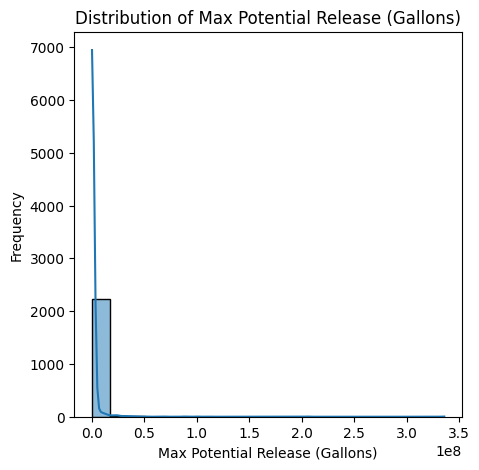

In [82]:
'''
i wanted to fill the data for the max_ptl_release_gallons and for this lets
initially plot the distrubution to know how the data is skewed
'''


# distribution of 'max_ptl_release_gallons'
plt.figure(figsize=(5, 5))
sns.histplot(df['max_ptl_release_gallons'].dropna(), bins=20, kde=True)
plt.title('Distribution of Max Potential Release (Gallons)')
plt.xlabel('Max Potential Release (Gallons)')
plt.ylabel('Frequency')
plt.show()

In [83]:
# now we can see our data is highly skewed with most values to the lower end.

#given this lets go with median imputation

# Fill missing 'max_ptl_release_gallons' with the median value
df['max_ptl_release_gallons'] = df['max_ptl_release_gallons'].fillna(df['max_ptl_release_gallons'].median())

# Verify cleaning
df.isnull().sum()

id                         0
open_date                  0
name                       0
location                   0
lat                        0
lon                        0
threat                     0
tags                       0
commodity                  0
measure_skim               0
measure_shore              0
measure_bio                0
measure_disperse           0
measure_burn               0
max_ptl_release_gallons    0
posts                      0
description                0
dtype: int64

In [84]:
# now lets get the basic statistics of our dataset

# Summary statistics
df.describe()

,id,open_date,lat,lon,measure_skim,measure_shore,measure_bio,measure_disperse,measure_burn,max_ptl_release_gallons,posts
count,4210.000000,4210,4210.000000,4210.000000,4210.000000,4210.000000,4210.000000,4210.000000,4210.000000,4.210000e+03,4210.000000
mean,7741.086698,2005-04-28 01:55:57.149643648,36.335721,-94.727658,0.058907,0.042280,0.004276,0.017102,0.011639,5.693743e+05,6.093349
min,1004.000000,1957-03-29 00:00:00,-78.000000,-197.050000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000
25%,6830.250000,1994-11-16 00:00:00,29.318749,-122.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000e+03,0.000000
50%,7903.500000,2007-11-07 12:00:00,35.786406,-89.968611,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000e+03,2.000000
75%,9302.750000,2016-06-14 18:00:00,42.236950,-76.705300,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000e+03,6.000000
max,10431.000000,2022-03-21 00:00:00,71.800000,182.600000,1.000000,1.000000,1.000000,1.000000,1.000000,3.360000e+08,380.000000
std,2139.334904,NaN,11.794040,39.767888,0.235479,0.201252,0.065255,0.129667,0.107267,7.141352e+06,18.523449


In [85]:
# Count of incidents by threat type
df['threat'].value_counts()

threat
Oil         2344
Unknown     1340
Chemical     276
Other        250
Name: count, dtype: int64

In [86]:
# Count of incidents by year
df['year'] = df['open_date'].dt.year

print(df['year'].value_counts())

year
2017    197
2008    192
2016    190
2020    187
2019    181
2018    180
2009    177
2021    173
1986    169
2015    154
1985    146
2007    131
2014    128
1998    117
1988    107
2003    105
1987    102
1994    102
2006     99
2004     96
1989     94
2013     92
2012     90
2005     89
1999     84
1997     83
2000     82
1991     80
2001     65
1996     61
1993     60
2010     59
1992     58
2011     47
1990     46
1995     42
1984     37
2022     28
2002     15
1979      8
1978      8
1977      7
1976      6
1975      6
1983      4
1970      4
1968      4
1980      3
1973      3
1972      3
1981      2
1971      2
1969      2
1967      1
1974      1
1957      1
Name: count, dtype: int64


## Visulizations

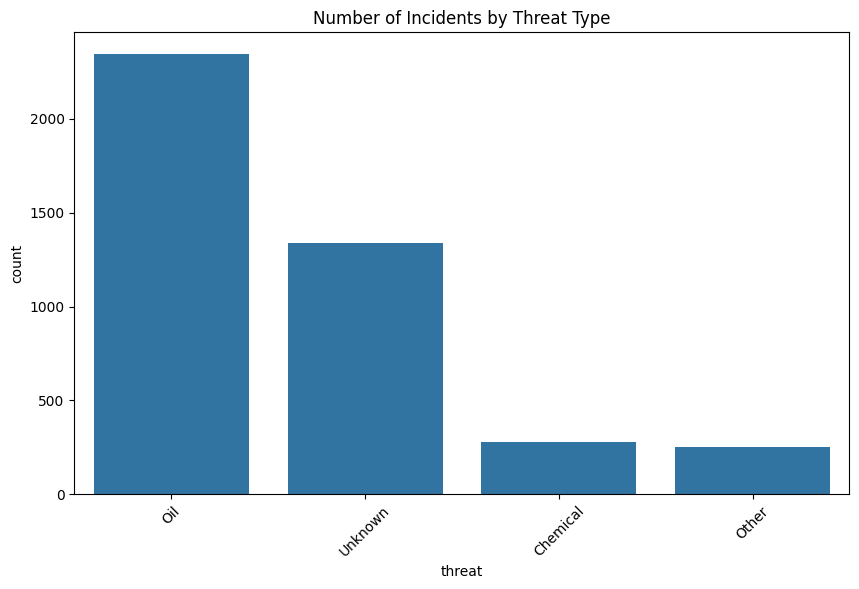

In [87]:
# Count of incidents by threat type
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='threat', order=df['threat'].value_counts().index)
plt.xticks(rotation=45)
plt.title('Number of Incidents by Threat Type')
plt.show()

Since our data was about oil spill it only makes sense that there are more cases of oil spil

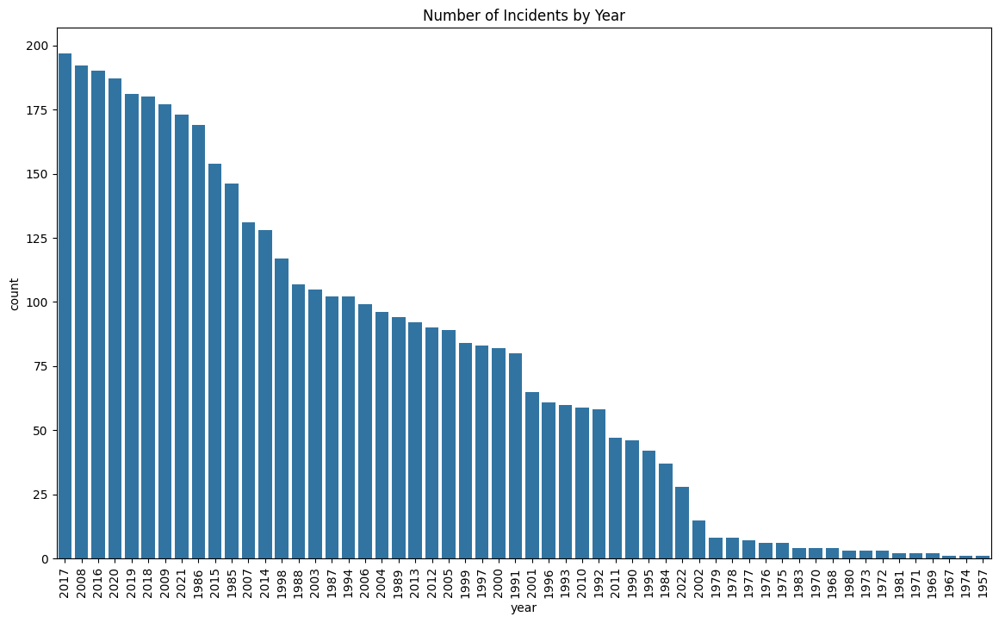

In [88]:
# Count of incidents by year
df['year'] = df['open_date'].dt.year
plt.figure(figsize=(14, 8))
sns.countplot(data=df, x='year', order=df['year'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Number of Incidents by Year')
plt.show()

 From this chart, we can observe trends over time.

 Here are some key points:

* Peak Years: There is a noticeable peak in incidents
during the years 2017, 2008, and 2016.

* Recent Decline: The number of incidents appears to decline in recent years, particularly after 2017.

* Historical Data: There are fewer recorded incidents before the 1980s, which could be due to less comprehensive reporting during those times.

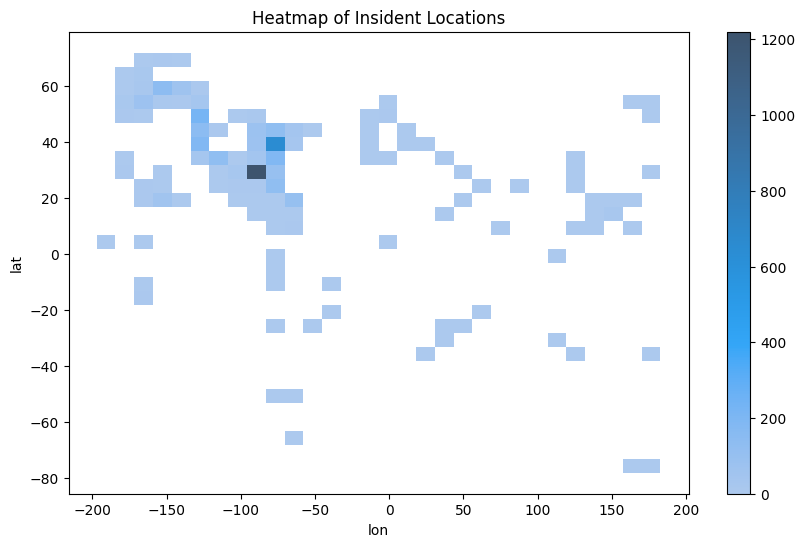

In [93]:
# heatmap of the insidents

plt.figure(figsize=(10,6))
sns.histplot(data=df, x='lon', y='lat', bins=30,cbar=True)
plt.title("Heatmap of Insident Locations")
plt.show()

the heatmap has nonsensical values but i wont be getting into it for now as the main purpose is to visulize the data using [pydeck](https://deckgl.readthedocs.io/en/latest/installation.html)


we already have install pydeck in our notebook before using pip install [here](https://colab.research.google.com/drive/16bAu3IH70IMRwBIsg5qw8rhA-Px1HYQa?authuser=1#scrollTo=Cc-D-yvAmLXU&line=1&uniqifier=1)

## Visulizations using pydeck

In [97]:
import pydeck as pdk

# Basic scatter plot of all incidents
layer = pdk.Layer(
    'ScatterplotLayer',
    data=df,
    get_position='[lon, lat]',
    get_radius=50000,
    get_color='[200, 30, 0, 160]',
    pickable=True
)

view_state = pdk.ViewState(
    latitude=37.7749,
    longitude=-122.4194,
    zoom=4,
    pitch=50,
)

r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip={"text": "{name}\n{location}\n{threat}"})
r.to_html('incident_map.html')

<IPython.core.display.Javascript object>

In [99]:
#heatmap of the insidents

heatmap_layer = pdk.Layer(
    'HeatmapLayer',
    data=df,
    get_position='[lon, lat]',
    get_weight='max_ptl_release_gallons',
    radius_pixels=60
)

heatmap_tooltip = {"text": "{name}\nLocation: {location}\nThreat: {threat}"}
heatmap_deck = pdk.Deck(layers=[heatmap_layer], initial_view_state=view_state, tooltip=heatmap_tooltip)
heatmap_deck.to_html('incident_heatmap.html')


<IPython.core.display.Javascript object>

Now when ploting the realease in gallons
we need to make sure that the range is standardized as we also saw it initially when creating the plot of distribution.

This is the only sklearn package that we will use in this project as of now


In [111]:

# lets standardize the max_ptl_release_gallons
scaler = StandardScaler()
df['scaled_release_gallons'] = scaler.fit_transform(df[['max_ptl_release_gallons']]) * 100000  # we are multipying it to make sure that the radii is huge and we can see it in our plots


#adjust the magnifying factor for better plots as needed

# Define the PyDeck scatter plot layer
impact_layer = pdk.Layer(
    'ScatterplotLayer',
    data=df,
    get_position='[lon, lat]',
    get_radius='scaled_release_gallons',
    get_color='[200, 30, 0, 160]',
    pickable=True,
    auto_highlight=True
)

# Define the initial view state
view_state = pdk.ViewState(
    latitude=37.7749,
    longitude=-122.4194,
    zoom=4,
    pitch=50
)

# Create the PyDeck deck
impact_tooltip = {"text": "{name}\nLocation: {location}\nThreat: {threat}"}
impact_deck = pdk.Deck(layers=[impact_layer], initial_view_state=view_state, tooltip=impact_tooltip)
impact_deck.to_html('incident_impact.html')


<IPython.core.display.Javascript object>

In [112]:
# even though this was supposed to be a threat specific to oil lets do a threat analysis

def get_threat_color(threat):
    colors = {
        'Oil': [255, 0, 0],
        'Chemical': [0, 255, 0],
        'Other': [0, 0, 255],
        'Unknown': [128, 128, 128]
    }
    return colors.get(threat, [128, 128, 128])

df['threat_color'] = df['threat'].apply(get_threat_color)

threat_layer = pdk.Layer(
    'ScatterplotLayer',
    data=df,
    get_position='[lon, lat]',
    get_fill_color='[threat_color[0], threat_color[1], threat_color[2], 150]',
    get_radius=50000,
    pickable=True,
    auto_highlight=True
)

threat_tooltip = {"text": "{name}\nLocation: {location}\nThreat: {threat}"}
threat_deck = pdk.Deck(layers=[threat_layer], initial_view_state=view_state, tooltip=threat_tooltip)
threat_deck.to_html('threat_specific.html')

<IPython.core.display.Javascript object>

I am an NLP enthusiast but I am really holding myself back how ever we can perform NER or train the model to identfiy the keyterms from the description and label the unknown data as well.

In [117]:
df['timestamp'] = pd.to_datetime(df['open_date']).astype(int) / 10**9

time_layer = pdk.Layer(
    'ScatterplotLayer',
    data=df,
    get_position='[lon, lat]',
    get_radius=50000,
    get_fill_color='[200, 30, 0, 160]',
    pickable=True,
    auto_highlight=True
)

time_deck = pdk.Deck(layers=[time_layer], initial_view_state=view_state, tooltip=heatmap_tooltip)
time_deck.update_trailing_animation = True
time_deck.to_html('time_based_animation.html')


<IPython.core.display.Javascript object>